# Load libraries

In [1]:
#Note: This notebook was run in the conda environment named "Jacob_Env1" (provided on GitHub)

In [2]:
#You are currently looking at the notebook processing/plotting keratinocytes only
cell_type = 'Epi'

In [3]:
#Load the required packages
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import os
import pandas as pd
import numpy as np
import sys
import seaborn as sbn
import scanpy as sc
import scvelo as scv
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import bbknn
from IPython.display import clear_output
from matplotlib.ticker import MaxNLocator
import cellrank as cr
from cellrank.tl.kernels import VelocityKernel
from cellrank.tl.kernels import ConnectivityKernel
from cellrank.tl.kernels import PalantirKernel
from cellrank.tl.estimators import GPCCA

In [4]:
#Set paths
path = '/mnt/c/Users/User/Jacob-Et-Al'

In [5]:
#Load gene list required for cell cycle scoring
cell_cycle_genes_path = os.path.join(path,'Notebook-Input','regev_lab_cell_cycle_genes.txt')
cell_cycle_genes = [x.strip().title() for x in open(cell_cycle_genes_path)]

# Separate dataset for S-phase or G2M-phase associated genes
s_genes = [x for x in cell_cycle_genes[:43]]
g2m_genes = [x for x in cell_cycle_genes[43:]]

In [6]:
scv.logging.print_version()
sc.logging.print_header()
cr.logging.print_versions()

Running scvelo 0.2.2 (python 3.7.7) on 2023-04-06 12:55.
scanpy==1.4.6 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.1.1 scikit-learn==0.23.2 statsmodels==0.12.0rc0 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.8.0
cellrank==1.1.0 scanpy==1.4.6 anndata==0.7.4 numpy==1.19.1 numba==0.51.0 scipy==1.5.2 pandas==1.1.1 scikit-learn==0.23.2 statsmodels==0.12.0rc0 python-igraph==0.7.1 scvelo==0.2.2 pygam==0.8.0 matplotlib==3.3.2 seaborn==0.10.1


In [7]:
#Define function that can remove axis elements from subplots
#axes can be either an individual subplot, a list of individual subplots or mix of multiple subplots in a nested list.
def clean_axis(axes, remove_borders = True, remove_ticks = True, remove_axis_labels = True):
    axes = flatten_list(axes)
    print(axes)
    for ax in axes:
        if remove_borders:
            for loc in ['left','right','top','bottom']:
                ax.spines[loc].set_visible(False)
        if remove_ticks:
            for side in ['x','y']:
                ax.tick_params(
                    axis=side,  # changes apply to the x-axis
                    which='both',  # both major and minor ticks are affected
                    bottom=False,  # ticks along the bottom edge are off
                    top=False,  # ticks along the top edge are off
                    left=False,
                    labelbottom=False,
                    labelleft=False,
                    labeltop = False)
        if remove_axis_labels:
            ax.set_ylabel('')
            ax.set_xlabel('')

#Define function to generate a plot with multiple subplots
def initialize_subplots(groups_to_plot, ncols = 3, figsize_multiplier = (7,5), gridspec_kw = None, figsize = None, print_help = True, **fig_kw):
    if type(groups_to_plot)==list:
        total = len(groups_to_plot)
    else:
        total = groups_to_plot
    nrows = int(np.ceil(total/ncols))
    if not figsize:
        figsize = (figsize_multiplier[0]*ncols, figsize_multiplier[1]*nrows)
    fig, axes = plt.subplots(nrows = nrows, ncols = ncols, figsize = figsize, gridspec_kw = gridspec_kw, **fig_kw)
    if print_help:
        if nrows>1 and ncols>1:
            print('ax = axes[ix // ncols, ix % ncols]')
        else:
            print('ax = axes[ix]')
    return fig, axes

In [ ]:
#Generate color bar for plotting gene expression levels on top of UMAP
colors = [(0.8, 0.8, 0.8), (0.19, 0.04, 0.55)] # first color is grey, last is dark purple
cm = LinearSegmentedColormap.from_list("Custom", colors, N=200)

# Import data

In [8]:
#Load adata object with preveiously calculated velocity
adata = sc.read_h5ad(os.path.join(path, 'Notebook-Output', 'Adata-object_{}.h5'.format(cell_type)))

In [9]:
adata

AnnData object with n_obs × n_vars = 1584 × 20001

## Import spliced and unspliced reads

In [ ]:
#Add information on spliced and unspliced reads from loom file (generated from original sequencing data)
velo_data = scv.read_loom(os.path.join(path, 'Notebook-Input', 'Jacob_Loom-File_All-Cells.loom'))

# Subanalysis for periderm differentiation (periderm cells only; Figure S6)

In [75]:
#Subset adata object to periderm cells only
adata_peri = adata[adata.obs['HC_named'].isin(['EPI Periderm'])].copy()

In [76]:
#Assign raw counts to .X, so analysis will be continued based on raw counts (we once again run reprocessing incl. log1p, etc.)
adata_peri.X = adata_peri.layers['raw'].copy()
tmp_data = adata[adata_peri.obs_names].copy()
tmp_data.X = adata[adata_peri.obs_names].layers['raw']
adata_peri.raw = tmp_data

In [77]:
#Determine which genes exist both in adata_peri and in velo_data (containing spliced and unspliced count data)
#Subset both velo_data and adata_peri to these shared genes, so we can assign spliced and unspliced count data to the adata object
shared_genes = velo_data.var_names.intersection(adata_peri.var_names)
velo_data_sub = velo_data[adata_peri.obs_names][:, shared_genes].copy()
adata_peri = adata_peri[:, shared_genes].copy()

adata_peri.layers['spliced'] = velo_data_sub.layers['spliced'].copy()
adata_peri.layers['unspliced'] = velo_data_sub.layers['unspliced'].copy()

In [78]:
#As we are starting from raw counts (as preprocessed data does not sufficiently capture dynamics in periderm), preprocessing needs to be done once more using Scanpy
sc.pp.filter_genes(adata_peri, min_counts = 5)
sc.pp.normalize_total(adata_peri)
sc.pp.log1p(adata_peri)
sc.pp.highly_variable_genes(adata_peri)

In [79]:
#Regress out cell cycle from .X layer
sc.pp.regress_out(adata_peri, keys = ['S.Score','G2M.Score','G1.Score'], )
sc.pp.scale(adata_peri)

In [80]:
#Regress out cell cycle and reassign corrected count matrices
spliced_adata = adata_peri.copy()
spliced_adata.X = spliced_adata.layers['spliced']
unspliced_adata = adata_peri.copy()
unspliced_adata.X = unspliced_adata.layers['unspliced']

sc.pp.regress_out(spliced_adata, keys = ['S.Score','G2M.Score','G1.Score'], )
sc.pp.scale(spliced_adata)
sc.pp.regress_out(unspliced_adata, keys = ['S.Score','G2M.Score','G1.Score'], )
sc.pp.scale(unspliced_adata)

adata_peri.layers['spliced'] = spliced_adata.X
adata_peri.layers['unspliced'] = unspliced_adata.X

In [81]:
#Run PCA on regressed data 
sc.pp.pca(adata_peri, n_comps = 100)
sc.pp.neighbors(adata_peri, n_pcs = 100, n_neighbors = 20)

In [82]:
#Correct for batch effect from sampling date with the help of BBKNN
bbknn.bbknn(adata_peri, batch_key='sample_date')

In [83]:
#Assign colors to categorical variable 'embryonic age'
adata_peri.uns['embryonic_age_colors']=['#E00D75','#85C100','#3399C1']

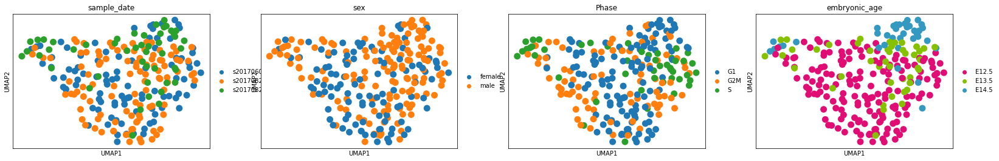

In [84]:
#Run UMAP and plot metadata from Seurat onto UMAP
sc.tl.umap(adata_peri, spread = 0.7, negative_sample_rate=5)
sc.pl.umap(adata_peri, color = ['sample_date','sex', 'Phase','embryonic_age'])

computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


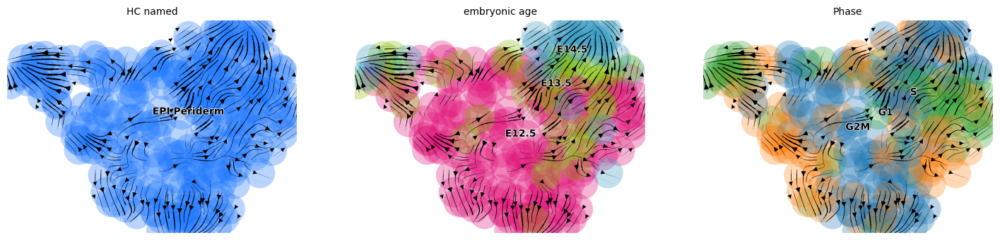

In [85]:
#Calculate and plot velocity on periderm cells only
scv.pp.moments(adata_peri, n_pcs = 100, n_neighbors = 20)
scv.tl.velocity(adata_peri)
scv.tl.velocity_graph(adata_peri, n_neighbors=20)
scv.pl.velocity_embedding_stream(adata_peri, color = ['HC_named', 'embryonic_age', 'Phase'], dpi = 100,smooth=0.8)

computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


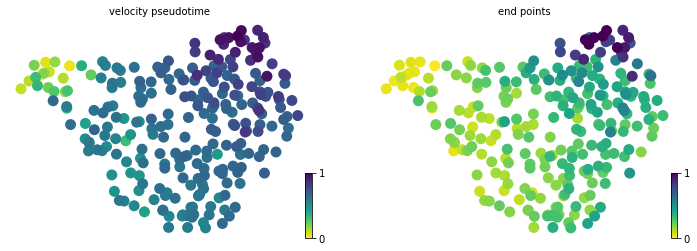

In [86]:
#Determine end states and calculate velocity pseudotime
scv.tl.terminal_states(adata_peri, self_transitions = False)
scv.tl.velocity_pseudotime(adata_peri)
scv.pl.scatter(adata_peri, color=['velocity_pseudotime', 'end_points'])

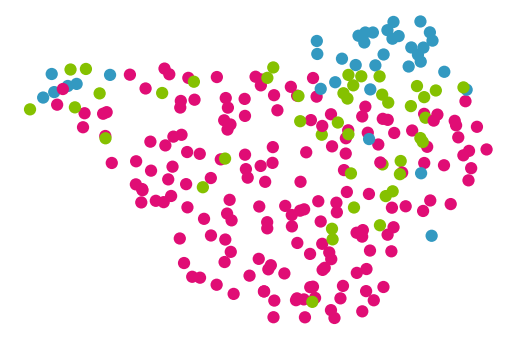

In [87]:
#Plot UMAP with overlaid embruyonic age
mult = 3
fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_peri, ax = ax, show = False, frameon = False, s = 600, title = '', alpha = 1,color='embryonic_age')
ax.legend().remove()
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_Periderm_Age.png'), transparent = True, bbox_inches = 'tight', dpi = 100)

In [88]:
#Set verbosity
scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo')
cr.settings.verbosity = 2

In [89]:
#Recalculate velocity graph based on connectivities
scv.tl.velocity_graph(adata_peri, mode_neighbors='connectivities')

computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [90]:
#Start the different kernels required for subsequent analysis
vk = VelocityKernel(adata_peri).compute_transition_matrix()
ck = ConnectivityKernel(adata_peri).compute_transition_matrix()
pk = PalantirKernel(adata_peri, time_key='velocity_pseudotime').compute_transition_matrix()

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=4.4817`



    Finish (0:00:00)
Computing transition matrix based on connectivities
    Finish (0:00:00)
Computing transition matrix based on Palantir-like kernel
    Finish (0:00:00)


In [91]:
#Combine the kernels with manually chosen weights for each kernel
combined_kernel = 0.33 * vk + 0.33 * ck + 0.33 * pk
g = GPCCA(combined_kernel)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[16]`
Adding `.eigendecomposition`
       `adata.uns['eig_fwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:00)


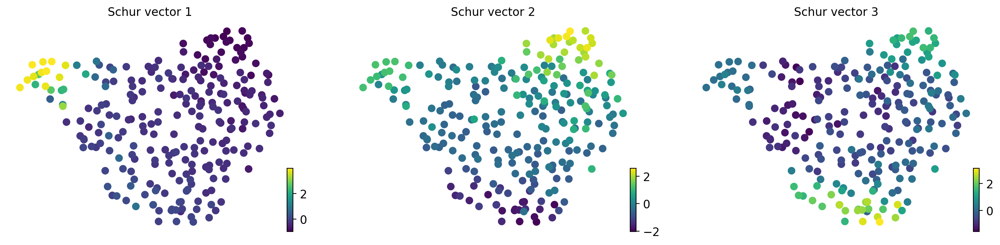

In [92]:
#Compute Schur decomposition and plot Schur vectors
g.compute_schur(n_components=20)
g.plot_schur(use=3)

Computing `2` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:00)


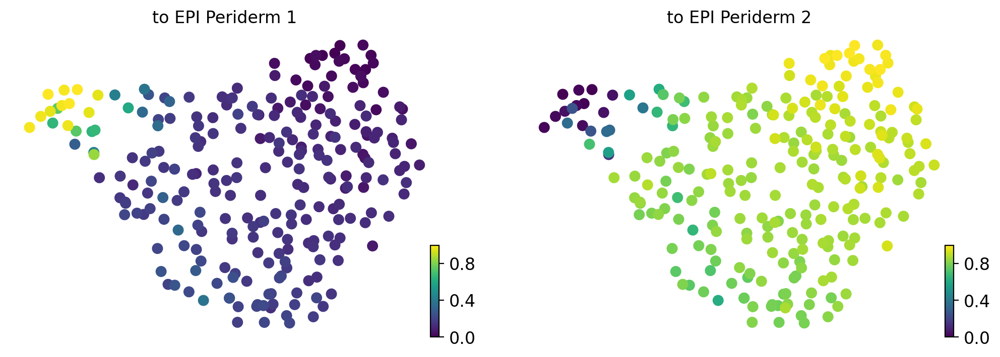

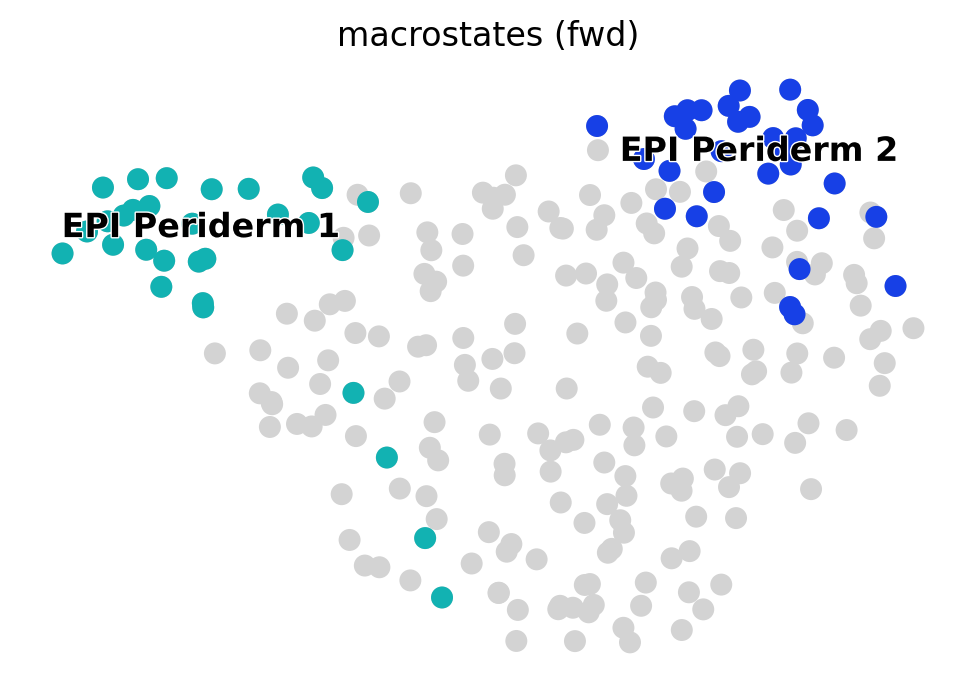

In [93]:
#Identify macrostates (needed for identifying lineage drivers of periderm maturation)
#n_states decides how many terminal states there should be
g.compute_macrostates(n_states=2, cluster_key='HC_named')
g.plot_macrostates(same_plot=False)
g.plot_macrostates(discrete=True)

In [94]:
#Compute absorption probabilities (needed for identifying lineage drivers of periderm maturation)
g.set_terminal_states_from_macrostates()
g.compute_absorption_probabilities()

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:00:00)


recovering dynamics
... 32%WARNING: Hsp90ab1 not recoverable due to insufficient samples.
... 91%WARNING: skipping bimodality check for Nedd4
    finished (0:00:46) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using root_cells, terminal_states_probs as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


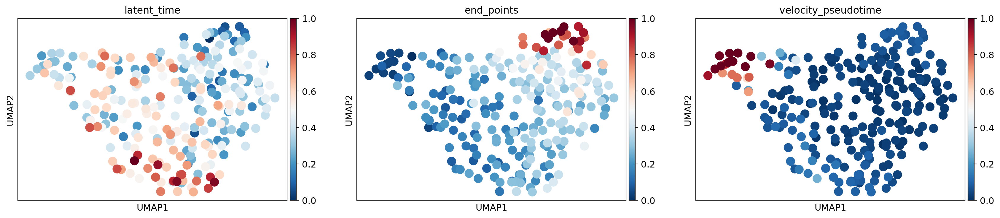

In [95]:
#Compute latent time and plot different methods for placing cells in a pseudotemporal order
scv.tl.recover_dynamics(adata_peri)
scv.tl.recover_latent_time(adata_peri, root_key='initial_states_probs', end_key='terminal_states_probs')
sc.pl.umap(adata_peri, color = ['latent_time', 'end_points','velocity_pseudotime'])
# "end points" best describes differentiation towards E14.5 periderm cells and thus was chosen as axis for plotting lineage drivers

No handles with labels found to put in legend.


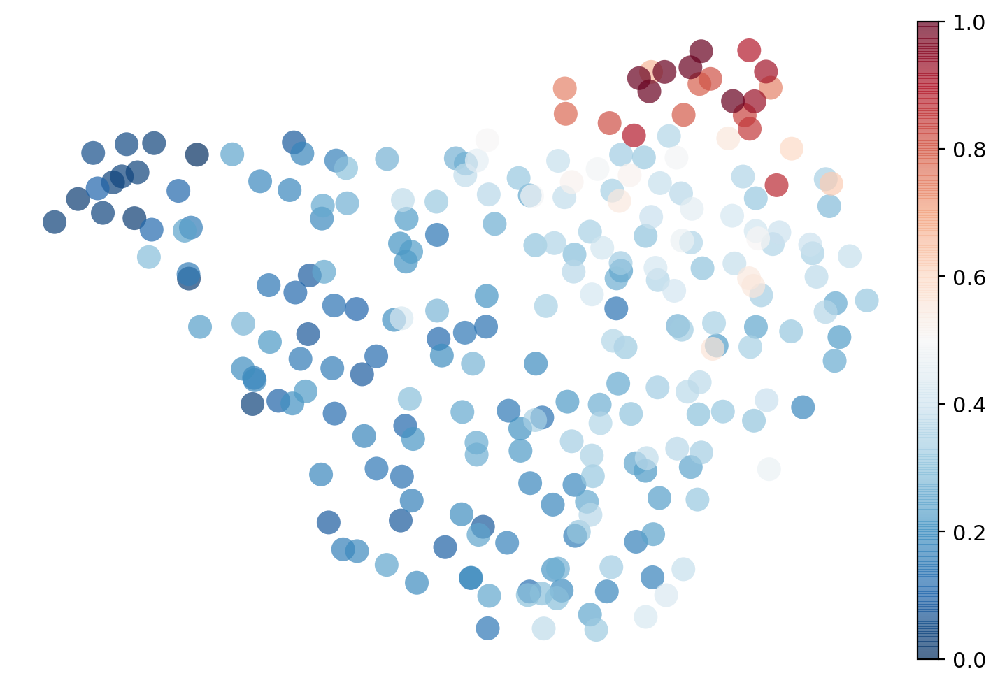

In [96]:
#Save plots
mult = 3
fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_peri, ax = ax, show = False, frameon = False, s = 600, title = '', alpha = 0.7,color='end_points')
ax.legend().remove()
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_Periderm_Ordering.png'), transparent = True, bbox_inches = 'tight', dpi = 100)

In [97]:
#Identify lineage drivers for "EPI Periderm_2" macrostate
cr.tl.lineage_drivers(adata_peri, lineages='EPI Periderm_2', use_raw=False, backward=False)

Computing correlations for lineages `['EPI Periderm_2']` restricted to clusters `None` in layer `X` with `use_raw=False`
Adding `.lineage_drivers`
       `adata.var['to EPI Periderm_2 corr']`
    Finish (0:00:00)


,EPI Periderm_2 corr,EPI Periderm_2 pval,EPI Periderm_2 qval,EPI Periderm_2 ci low,EPI Periderm_2 ci high
Anxa1,0.636417,3.054309e-32,3.622716e-28,0.556272,0.704831
Meg3,0.586849,3.907868e-26,1.545041e-22,0.499123,0.662668
Gabrp,0.574572,8.366134e-25,1.984614e-21,0.485084,0.652150
Gm16136,0.569808,2.639947e-24,5.218736e-21,0.479650,0.648061
Cldn3,0.562114,1.615064e-23,2.394535e-20,0.470887,0.641447
...,...,...,...,...,...
Hoxa7,-0.522382,8.293108e-20,7.566504e-17,-0.607102,-0.425918
Cxcl14,-0.551324,1.872382e-22,2.220832e-19,-0.632151,-0.458628
Hpgds,-0.567396,4.685638e-24,7.939479e-21,-0.645989,-0.476900
Trp63,-0.585015,6.235591e-26,1.849009e-22,-0.661099,-0.497023


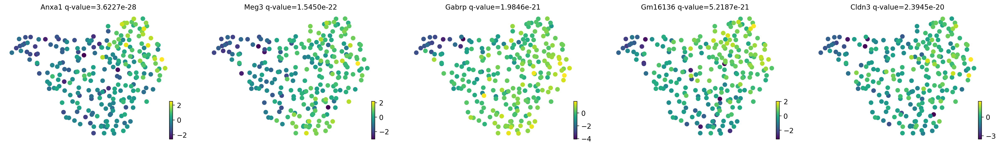

In [98]:
#Plot top 5 lineage drivers for "EPI Periderm_2"
cr.pl.lineage_drivers(adata_peri, lineage="EPI Periderm_2", n_genes=5)

In [99]:
#Generate GAM model
model = cr.ul.models.GAM(adata_peri, grid=None)

Computing trends using `1` core(s)


did not converge

    Finish (0:00:08)


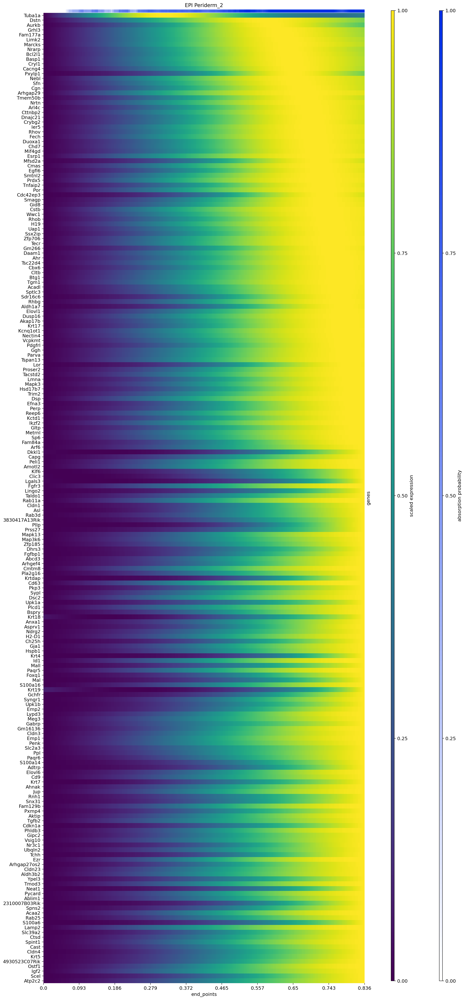

In [100]:
#Plot lineage drivers for Periderm maturaiton (lineage drivers of "EPI Periderm_2 macrostate)
n_genes = 200
genes = adata_peri.var['to EPI Periderm_2 corr'].sort_values(ascending=False).index[:n_genes]
ax = cr.pl.heatmap(adata_peri, model, genes=genes, figsize = (15, n_genes/5),
              show_absorption_probabilities=True,
              lineages="EPI Periderm_2", n_jobs=1, backend='loky', use_raw = True, show_all_genes=True,time_key='end_points')

genes= ['S100a6','2310007B03Rik','Neat1','Ypel3','Tchh','Cdkn1a','Pxmp4','Rnh1','Snx31','Krt7','Adtrp','S100a14','Gabrp','Krt19','Mal','Foxq1','Mall','Krt4','Ch25h','Krt18','Upk1a','Krtdap','Dhrs3','Prss27','Pllp','Lingo2','Lgals3','Clic3','Klf6','Dkkl1','Lor','Aldh1a7']

13
Computing trends using `1` core(s)


did not converge

    Finish (0:00:03)


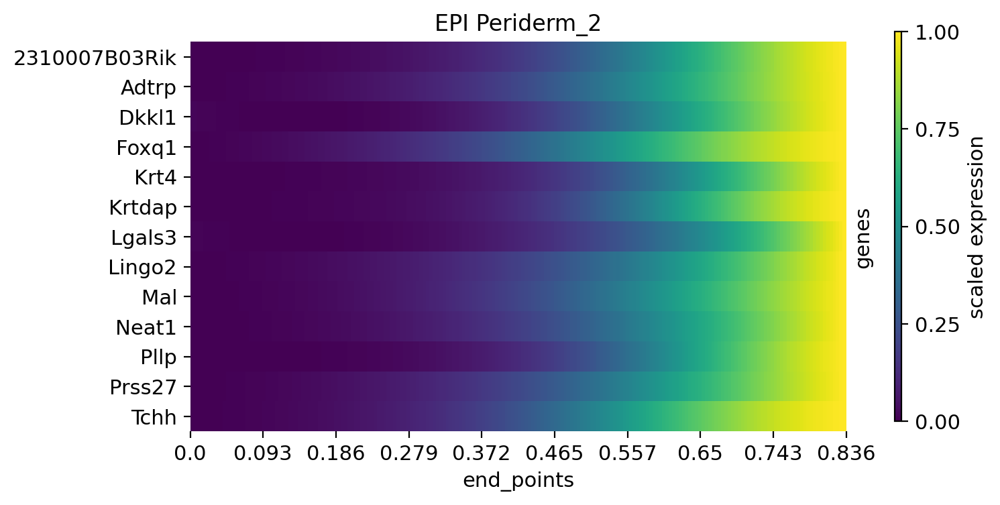

In [101]:
# Plot selected genes from the heatmap above. We manually selected genes that come up late in the periderm differentiation process
genes= sorted(['Mal','Foxq1','Krt4','Prss27','Pllp','Lingo2','Tchh','Lgals3','Dkkl1','Krtdap','Neat1','2310007B03Rik','Adtrp'])
print(len(genes))
ax = cr.pl.heatmap(adata_peri, model, genes=genes, figsize = (8, 4),
              show_absorption_probabilities=False,
              lineages="EPI Periderm_2", n_jobs=1, backend='loky', use_raw = True, show_all_genes=True,time_key='end_points',save=os.path.join(path, 'Notebook-Output', 'EPI_PeridermHeatmap.png'),dpi=100)

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


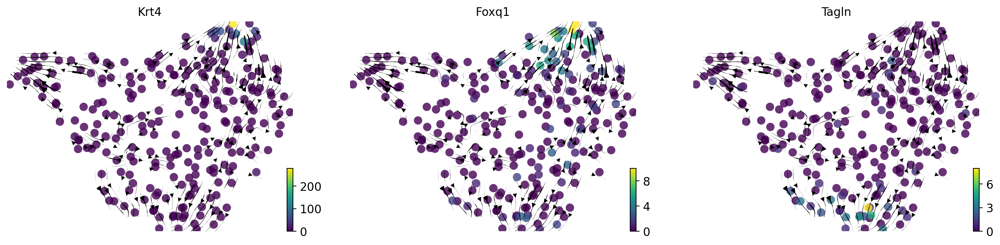

In [102]:
#Optional: Plot velocity arrows and gene expression onto UMAP
scv.pl.velocity_embedding_stream(adata_peri, color = ['Krt4','Foxq1','Tagln'], cmap = 'viridis', ncols = 3,alpha=0.8,size=300)

## Save adata object as h5ad file

In [103]:
adata_peri.write_h5ad(os.path.join(path, 'Notebook-Output', 'Adata-object_{}-Periderm.h5'.format(cell_type)))

# Subanalysis for IFE differentiation (relevant E14.5 IFE cells only; Figure 7 and S6)

## Without cell cycle regression

In [104]:
#Subset adata object to E14.5 cells involved in IFE differentiation only (excluding placode and periderm cells and EPI BasalTagln cells that are mostly present at E12.5 when IFE differentiation hasn't started yet)
adata_ife = adata[adata.obs['embryonic_age'] == 'E14.5'].copy()
adata_ife = adata_ife[adata_ife.obs['HC_named'].isin(['EPI Basal1','EPI Basal2','EPI Basal3','EPI Basal4','EPI EarlyDiff','EPI LateDiff'])].copy()

In [105]:
#Assign raw counts to .X, so analysis will be continued based on raw counts (we once again run reprocessing incl. log1p, etc.)
adata_ife.X = adata_ife.layers['raw'].copy()
tmp_data = adata[adata_ife.obs_names].copy()
tmp_data.X = adata[adata_ife.obs_names].layers['raw']
adata_ife.raw = tmp_data

In [106]:
#Determine which genes exist both in adata_ife and in velo_data (containing spliced and unspliced count data)
#Subset both velo_data and adata_ife to these shared genes, so we can assign spliced and unspliced count data to the adata object
shared_genes = velo_data.var_names.intersection(adata_ife.var_names)
velo_data_sub = velo_data[adata_ife.obs_names][:, shared_genes].copy()
adata_ife = adata_ife[:, shared_genes].copy()

adata_ife.layers['spliced'] = velo_data_sub.layers['spliced'].copy()
adata_ife.layers['unspliced'] = velo_data_sub.layers['unspliced'].copy()

In [107]:
#As we are starting from raw counts (as preprocessed data does not sufficiently capture dynamics in IFE differentiation), preprocessing needs to be done once more using Scanpy
sc.pp.filter_genes(adata_ife, min_counts = 5)
sc.pp.normalize_total(adata_ife)
sc.pp.log1p(adata_ife)
sc.pp.highly_variable_genes(adata_ife)

In [108]:
#Run PCA 
sc.pp.pca(adata_ife, n_comps = 100)
sc.pp.neighbors(adata_ife, n_pcs = 100, n_neighbors = 20)

In [109]:
#Correct for batch effect from sampling date with the help of BBKNN
bbknn.bbknn(adata_ife, batch_key='sample_date')

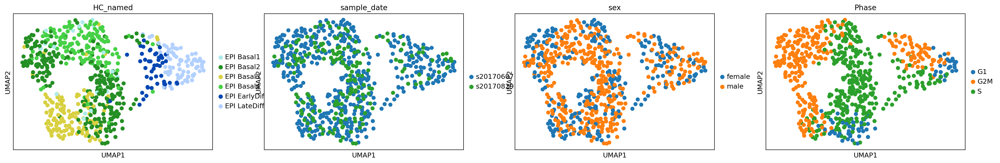

[<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Cdh1'}, xlabel='UMAP1', ylabel='UMAP2'>]

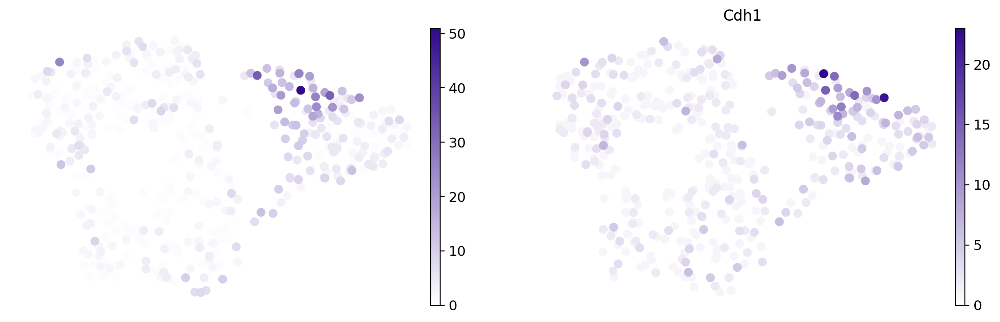

In [110]:
#Run UMAP and plot metadata from Seurat onto UMAP
sc.tl.umap(adata_ife, spread = 0.7, negative_sample_rate=5)
sc.pl.umap(adata_ife, color = ['HC_named', 'sample_date','sex', 'Phase'])
sc.pl.umap(adata_ife, show = False, frameon = False, s = 200, title = '', alpha = 2,color=['Notch1','Cdh1'],cmap=cm)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


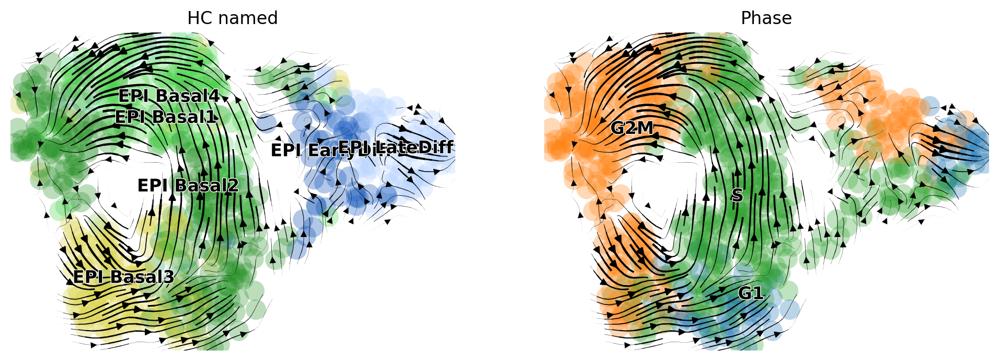

In [111]:
#Calculate and plot velocity on IFE cells only
scv.pp.moments(adata_ife, n_pcs = 100, n_neighbors = 20)
scv.tl.velocity(adata_ife)
scv.tl.velocity_graph(adata_ife, n_neighbors=20)
scv.pl.velocity_embedding_stream(adata_ife, color = ['HC_named', 'Phase'], dpi = 100,smooth=0.8)

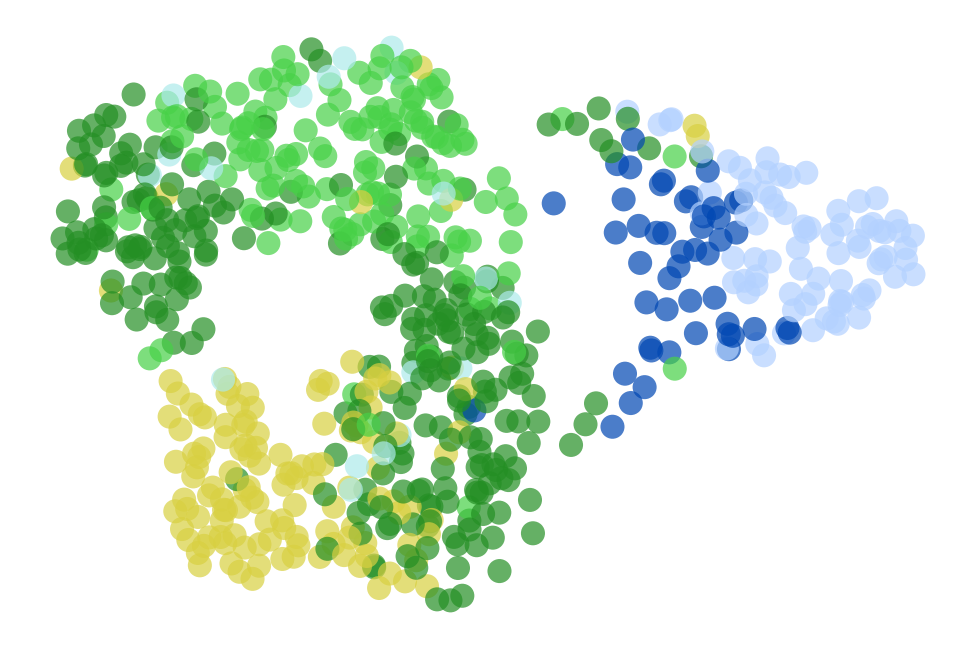

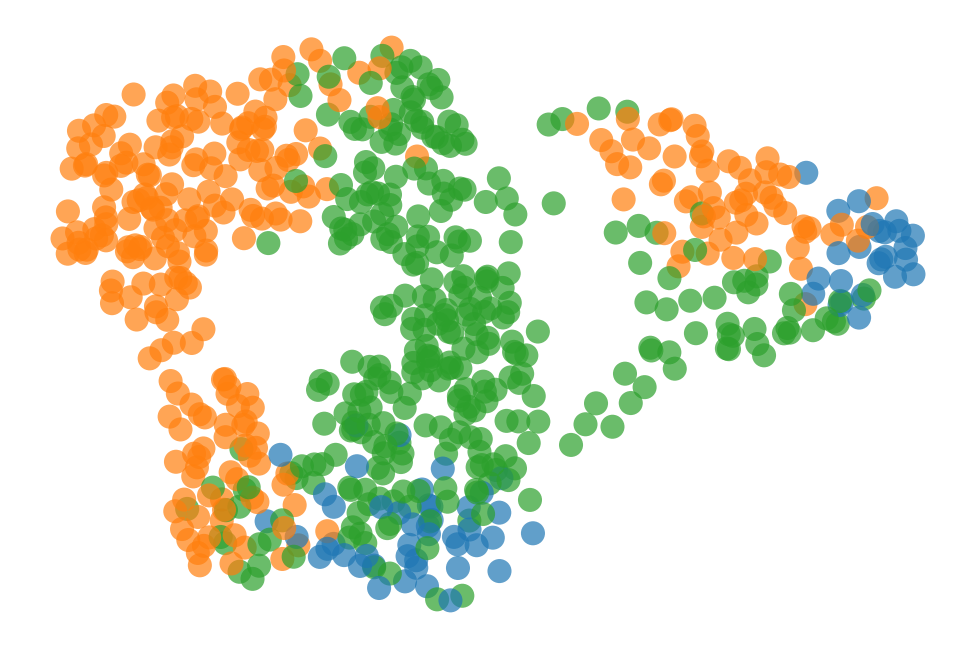

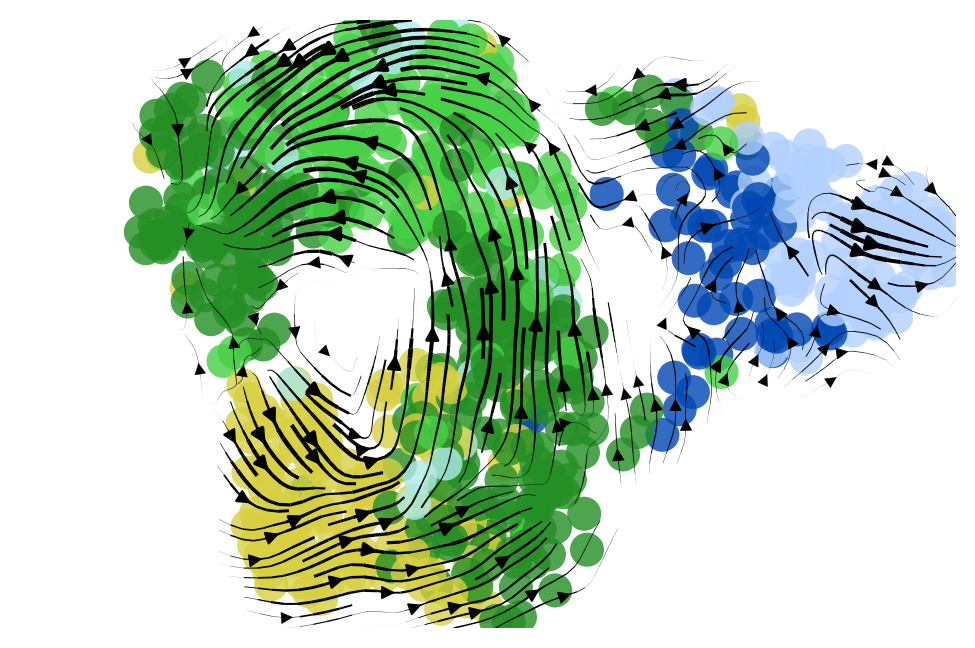

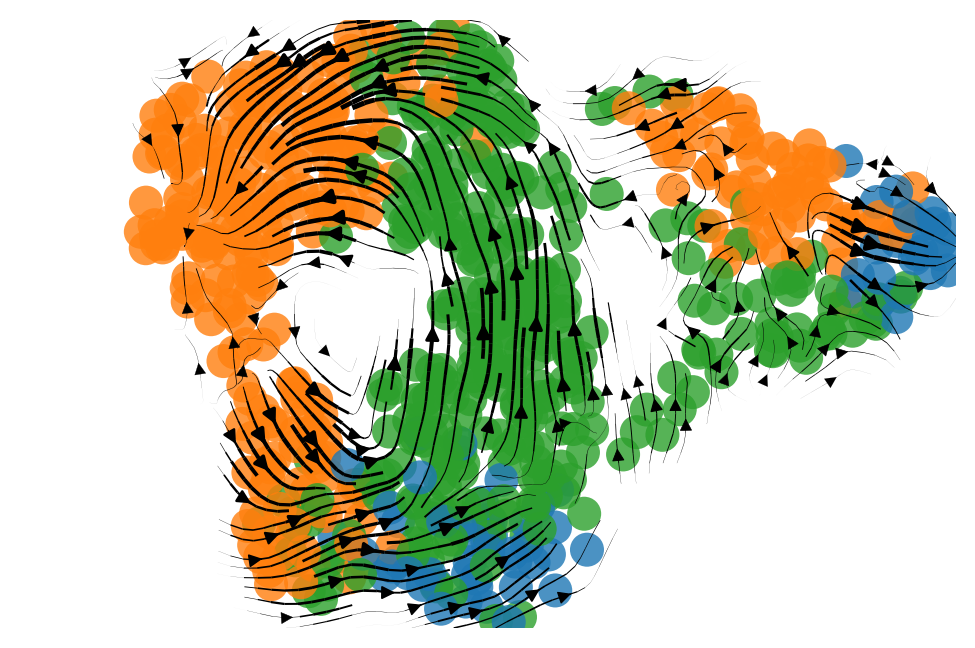

In [112]:
#Save plots
mult = 2
fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_ife, ax = ax, show = False, frameon = False, s = 300, title = '', alpha = 0.7,color='HC_named')
ax.legend().remove()
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_Prior-CC-Regression_Clustering.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_ife, ax = ax, show = False, frameon = False, s = 300, title = '', alpha = 0.7,color='Phase')
ax.legend().remove()
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_Prior-CC-Regression_Phase.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
scv.pl.velocity_embedding_stream(adata_ife, color = ['HC_named'], dpi = 100,smooth=0.8,alpha=0.8,ax = ax, show = False, frameon = False,size=600,linewidth=1,legend_loc='right')
ax.legend().remove()
ax.set_title('')
ax.set_xlim(left = ax.get_xlim()[0]+(ax.get_xlim()[0])*0.5)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_Prior-CC-Regression_Velocity-Clustering.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
scv.pl.velocity_embedding_stream(adata_ife, color = ['Phase'], dpi = 100,smooth=0.8,alpha=0.8,ax = ax, show = False, frameon = False,size=600,linewidth=1,legend_loc='right')
ax.legend().remove()
ax.set_title('')
ax.set_xlim(left = ax.get_xlim()[0]+(ax.get_xlim()[0])*0.5)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_Prior-CC-Regression_Velocity-Phase.png'), transparent = True, dpi = 100)

## With cell cycle regression

In [113]:
#Subset adata object to E14.5 cells involved in IFE differentiation only (excluding placode and periderm cells and EPI BasalTagln cells that are mostly present at E12.5 when IFE differentiation hasn't started yet)
adata_ife = adata[adata.obs['embryonic_age'] == 'E14.5'].copy()
adata_ife = adata_ife[adata_ife.obs['HC_named'].isin(['EPI Basal1','EPI Basal2','EPI Basal3','EPI Basal4','EPI EarlyDiff','EPI LateDiff'])].copy()

In [114]:
#Assign raw counts to .X, so analysis will be continued based on raw counts (we once again run reprocessing incl. log1p, etc.)
adata_ife.X = adata_ife.layers['raw'].copy()
tmp_data = adata[adata_ife.obs_names].copy()
tmp_data.X = adata[adata_ife.obs_names].layers['raw']
adata_ife.raw = tmp_data

In [115]:
#Determine which genes exist both in adata_ife and in velo_data (containing spliced and unspliced count data)
#Subset both velo_data and adata_ife to these shared genes, so we can assign spliced and unspliced count data to the adata object
shared_genes = velo_data.var_names.intersection(adata_ife.var_names)
velo_data_sub = velo_data[adata_ife.obs_names][:, shared_genes].copy()
adata_ife = adata_ife[:, shared_genes].copy()

adata_ife.layers['spliced'] = velo_data_sub.layers['spliced'].copy()
adata_ife.layers['unspliced'] = velo_data_sub.layers['unspliced'].copy()

In [116]:
#As we are starting from raw counts (as preprocessed data does not sufficiently capture dynamics in IFE differentiation), preprocessing needs to be done once more using Scanpy
sc.pp.filter_genes(adata_ife, min_counts = 5)
sc.pp.normalize_total(adata_ife)
sc.pp.log1p(adata_ife)
sc.pp.highly_variable_genes(adata_ife)

In [117]:
#Regress out cell cycle from .X layer
sc.pp.regress_out(adata_ife, keys = ['S.Score','G2M.Score','G1.Score'], )
sc.pp.scale(adata_ife)

In [118]:
#Regress out cell cycle and reassign corrected count matrices
spliced_adata = adata_ife.copy()
spliced_adata.X = spliced_adata.layers['spliced']
unspliced_adata = adata_ife.copy()
unspliced_adata.X = unspliced_adata.layers['unspliced']

sc.pp.regress_out(spliced_adata, keys = ['S.Score','G2M.Score','G1.Score'], )
sc.pp.scale(spliced_adata)
sc.pp.regress_out(unspliced_adata, keys = ['S.Score','G2M.Score','G1.Score'], )
sc.pp.scale(unspliced_adata)

adata_ife.layers['spliced'] = spliced_adata.X
adata_ife.layers['unspliced'] = unspliced_adata.X

In [119]:
#Run PCA 
sc.pp.pca(adata_ife, n_comps = 100)
sc.pp.neighbors(adata_ife, n_pcs = 100, n_neighbors = 20)

In [120]:
#Correct for batch effect from sampling date with the help of BBKNN
bbknn.bbknn(adata_ife, batch_key='sample_date')

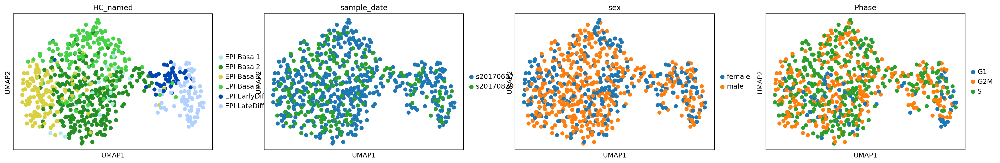

[<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Cdh1'}, xlabel='UMAP1', ylabel='UMAP2'>]

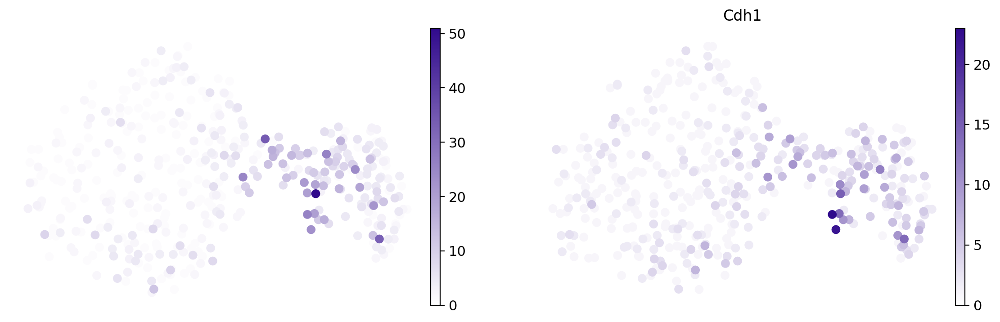

In [121]:
#Run UMAP and plot metadata from Seurat onto UMAP
sc.tl.umap(adata_ife, spread = 0.7, negative_sample_rate=5)
sc.pl.umap(adata_ife, color = ['HC_named', 'sample_date','sex', 'Phase'])
sc.pl.umap(adata_ife, show = False, frameon = False, s = 200, title = '', alpha = 2,color=['Notch1','Cdh1'],cmap=cm)

computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


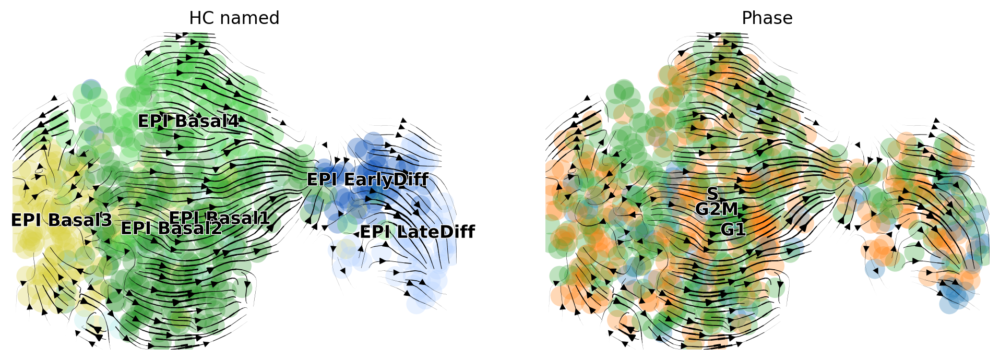

In [122]:
#Calculate and plot velocity on IFE cells only
scv.pp.moments(adata_ife, n_pcs = 100, n_neighbors = 20)
scv.tl.velocity(adata_ife)
scv.tl.velocity_graph(adata_ife, n_neighbors=20)
scv.pl.velocity_embedding_stream(adata_ife, color = ['HC_named', 'Phase'], dpi = 100,smooth=0.8)

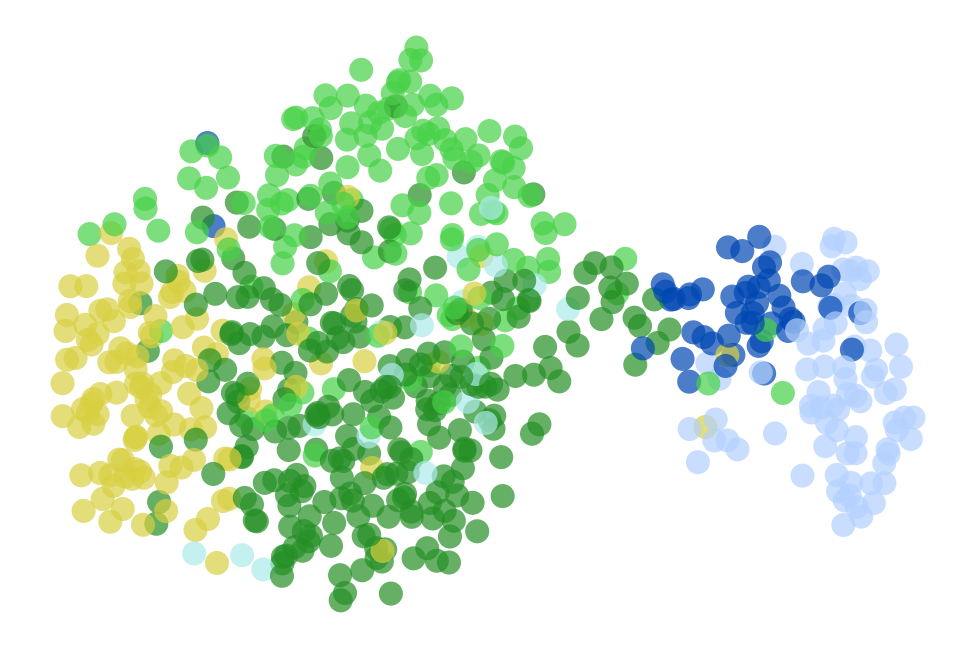

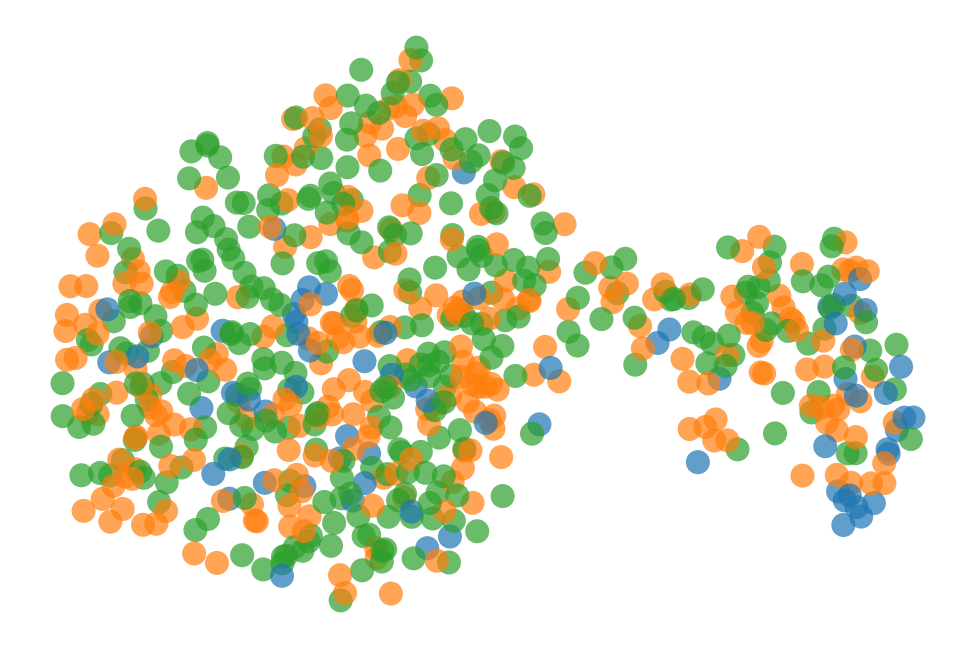

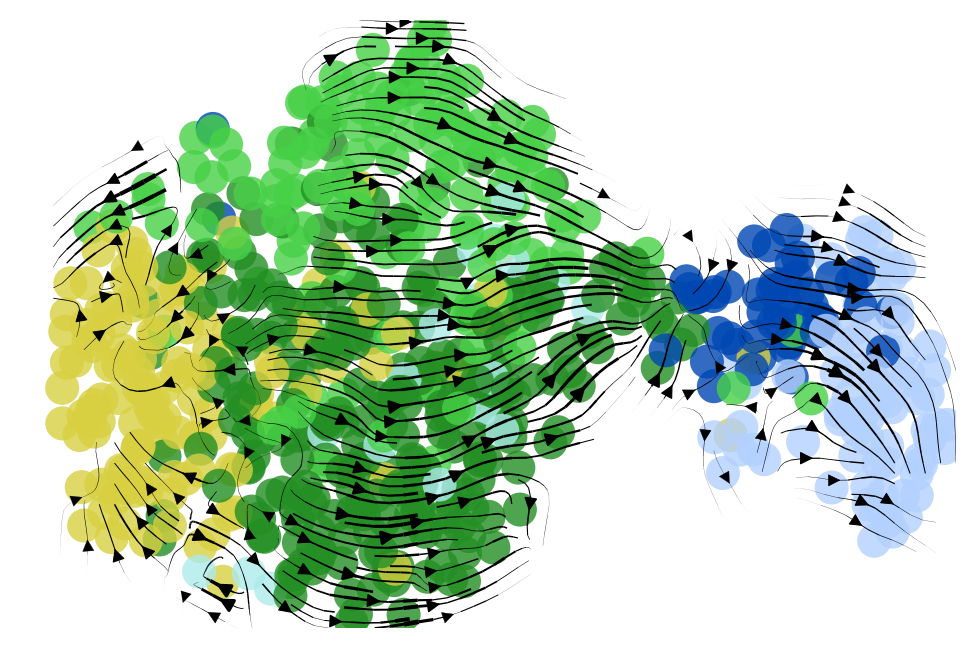

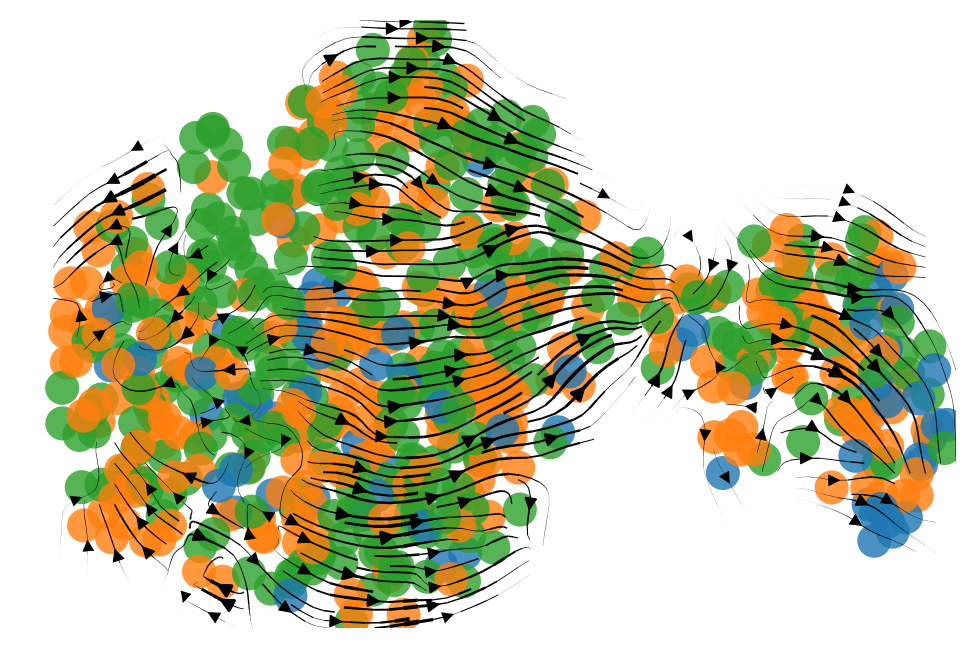

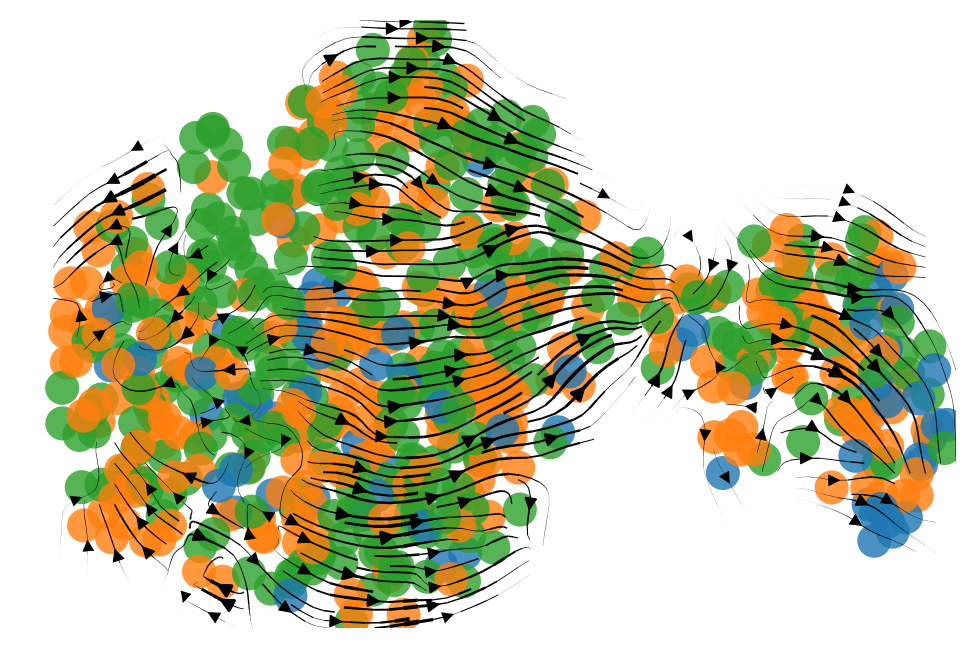

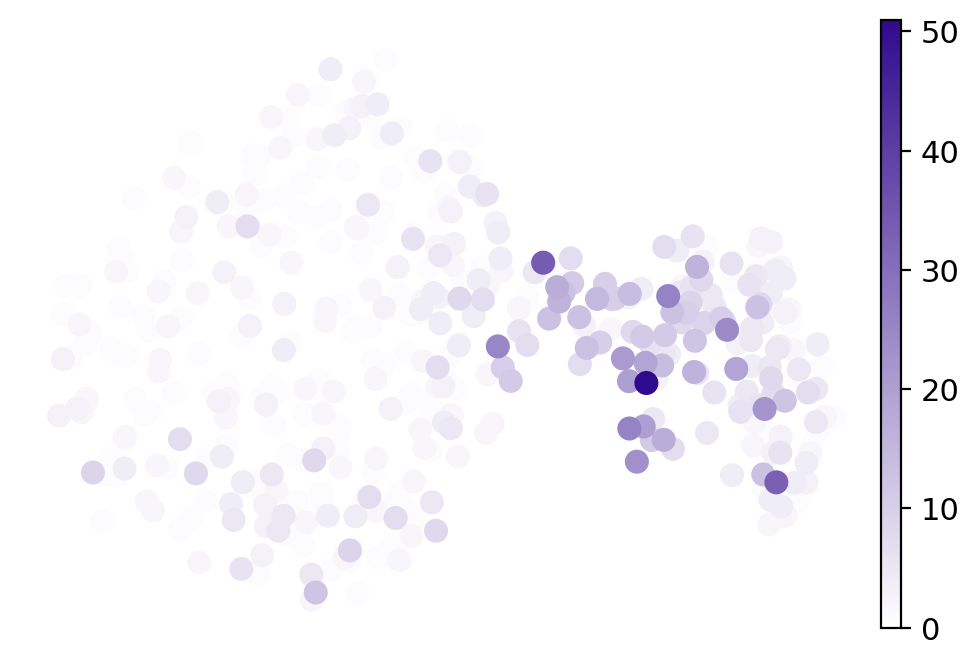

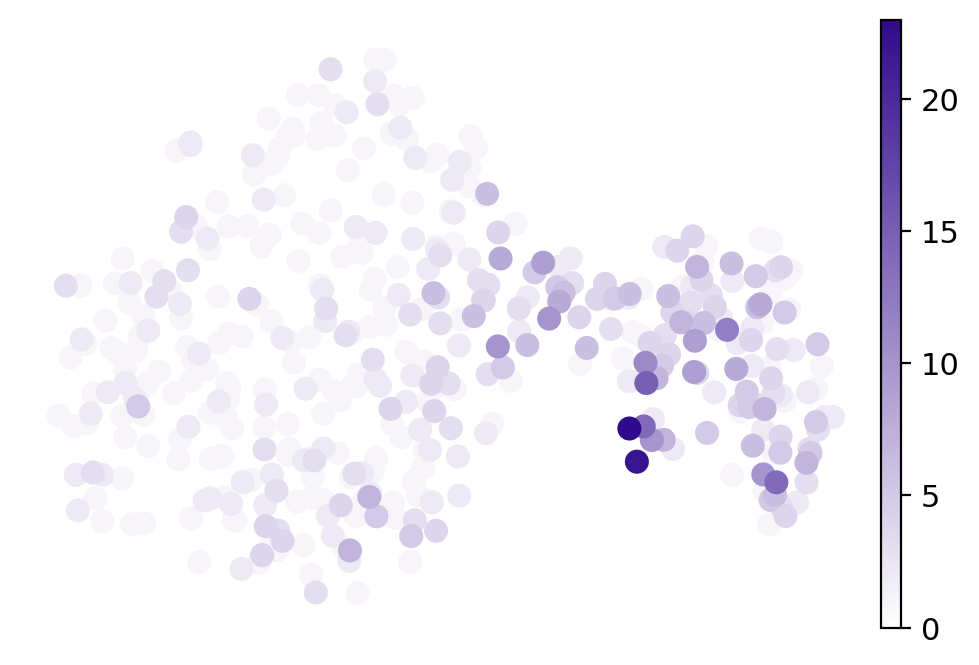

In [123]:
#Save plots
mult = 2
fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_ife, ax = ax, show = False, frameon = False, s = 300, title = '', alpha = 0.7,color='HC_named')
ax.legend().remove()
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Clustering.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_ife, ax = ax, show = False, frameon = False, s = 300, title = '', alpha = 0.7,color='Phase')
ax.legend().remove()
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Phase.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
scv.pl.velocity_embedding_stream(adata_ife, color = ['HC_named'], dpi = 100,smooth=0.8,alpha=0.8,ax = ax, show = False, frameon = False,size=600,linewidth=1,legend_loc='right')
ax.legend().remove()
ax.set_title('')
ax.set_xlim(left = ax.get_xlim()[0]+(ax.get_xlim()[0])*0.5)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Velocity-Clustering.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
scv.pl.velocity_embedding_stream(adata_ife, color = ['Phase'], dpi = 100,smooth=0.8,alpha=0.8,ax = ax, show = False, frameon = False,size=600,linewidth=1,legend_loc='right')
ax.legend().remove()
ax.set_title('')
ax.set_xlim(left = ax.get_xlim()[0]+(ax.get_xlim()[0])*0.5)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Velocity-Phase.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
scv.pl.velocity_embedding_stream(adata_ife, color = ['Phase'], dpi = 100,smooth=0.8,alpha=0.8,ax = ax, show = False, frameon = False,size=600,linewidth=1,legend_loc='right')
ax.legend().remove()
ax.set_title('')
ax.set_xlim(left = ax.get_xlim()[0]+(ax.get_xlim()[0])*0.5)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Velocity-Phase.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_ife, ax=ax, show = False, frameon = False, s = 300, title = '', alpha = 2,color='Notch1',cmap=cm)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Notch1.png'), transparent = True, dpi = 100)

fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_ife, ax=ax, show = False, frameon = False, s = 300, title = '', alpha = 2,color='Cdh1',cmap=cm)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Cdh1.png'), transparent = True, dpi = 100)

## Pseudotime modelling (on regressed data)

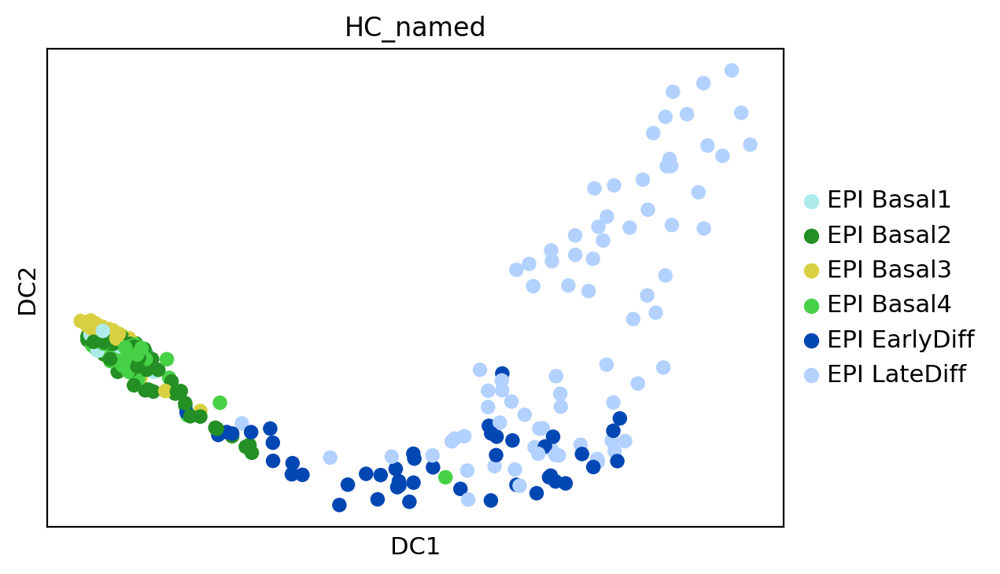

In [124]:
#Generate diffusion map
sc.tl.diffmap(adata_ife)
sc.pl.diffmap(adata_ife, color = 'HC_named')

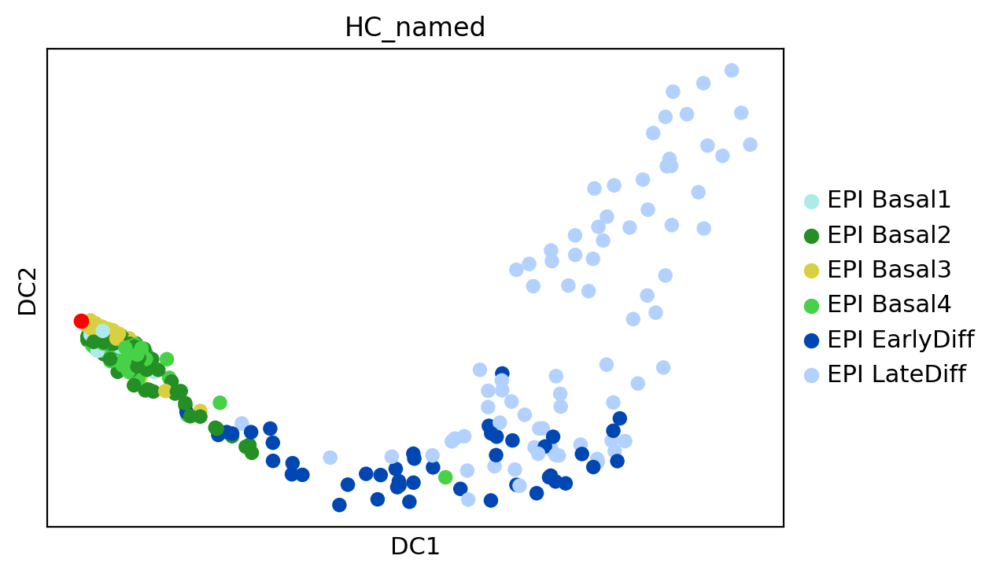

In [125]:
#Identify root cell (left-most cell in diffusion map)
iroot = [np.argmin(adata_ife.obsm['X_diffmap'][:, 1])][0]
iroot_cell = adata_ife.obs_names[iroot]
iroot_cell
#'CGTTCTGCAAAGTGCG_10x_17_036_14' was chosen as root cell

#Visualize root cell on diffusion map
ax = sc.pl.diffmap(adata_ife, color = 'HC_named', show = False)
ax.scatter(adata_ife.obsm['X_diffmap'][iroot][1], adata_ife.obsm['X_diffmap'][iroot][2], c = 'r')

#Set the root cell
adata_ife.uns['iroot'] = iroot

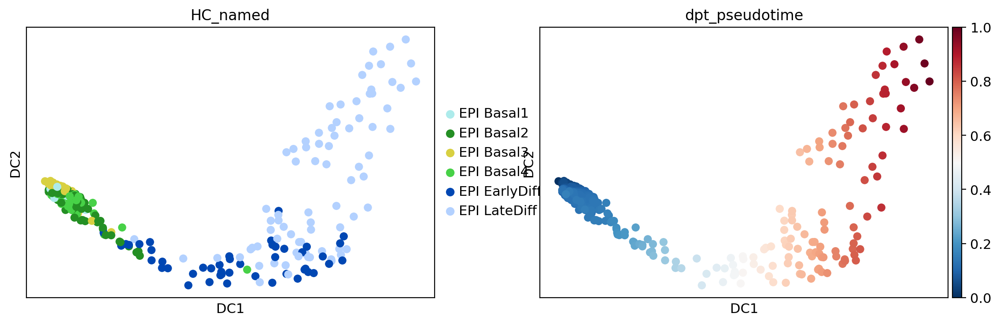

In [126]:
#Determine and visualize diffusion pseudotime
sc.tl.dpt(adata_ife)
sc.pl.diffmap(adata_ife, color = ['HC_named', 'dpt_pseudotime'])

computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


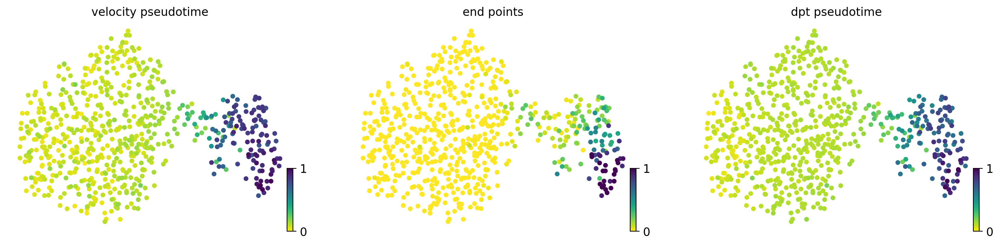

In [127]:
#Determine end states and calculate velocity pseudotime
scv.tl.terminal_states(adata_ife, self_transitions = False)
scv.tl.velocity_pseudotime(adata_ife)
scv.pl.scatter(adata_ife, color=['velocity_pseudotime', 'end_points', 'dpt_pseudotime'])

In [128]:
#Set verbosity
scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo')
cr.settings.verbosity = 2

In [129]:
#Recalculate velocity graph based on connectivities
scv.tl.velocity_graph(adata_ife, mode_neighbors='connectivities')

computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [130]:
#Start the different kernels required for subsequent analysis
vk = VelocityKernel(adata_ife).compute_transition_matrix()
ck = ConnectivityKernel(adata_ife).compute_transition_matrix()
pk = PalantirKernel(adata_ife, time_key='dpt_pseudotime').compute_transition_matrix()

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=7.2508`



    Finish (0:00:01)
Computing transition matrix based on connectivities
    Finish (0:00:00)
Computing transition matrix based on Palantir-like kernel
    Finish (0:00:00)


In [131]:
#Combine the kernels with manually chosen weights for each kernel
combined_kernel = 0.33 * vk + 0.33 * ck + 0.33 * pk
g = GPCCA(combined_kernel)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[20]`
Adding `.eigendecomposition`
       `adata.uns['eig_fwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:00)


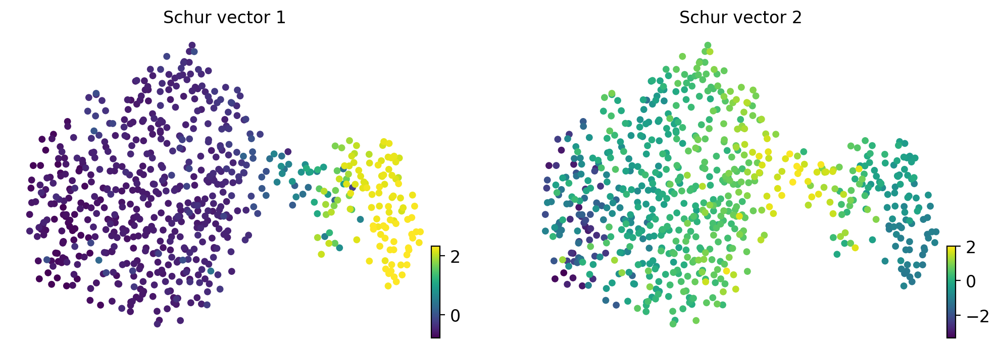

In [132]:
#Compute Schur decomposition and plot Schur vectors
g.compute_schur(n_components=20)
g.plot_schur(use=2)

Computing `2` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:00)


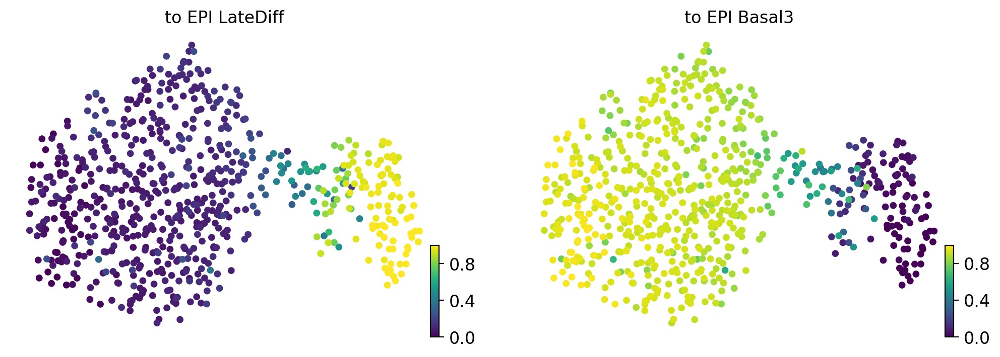

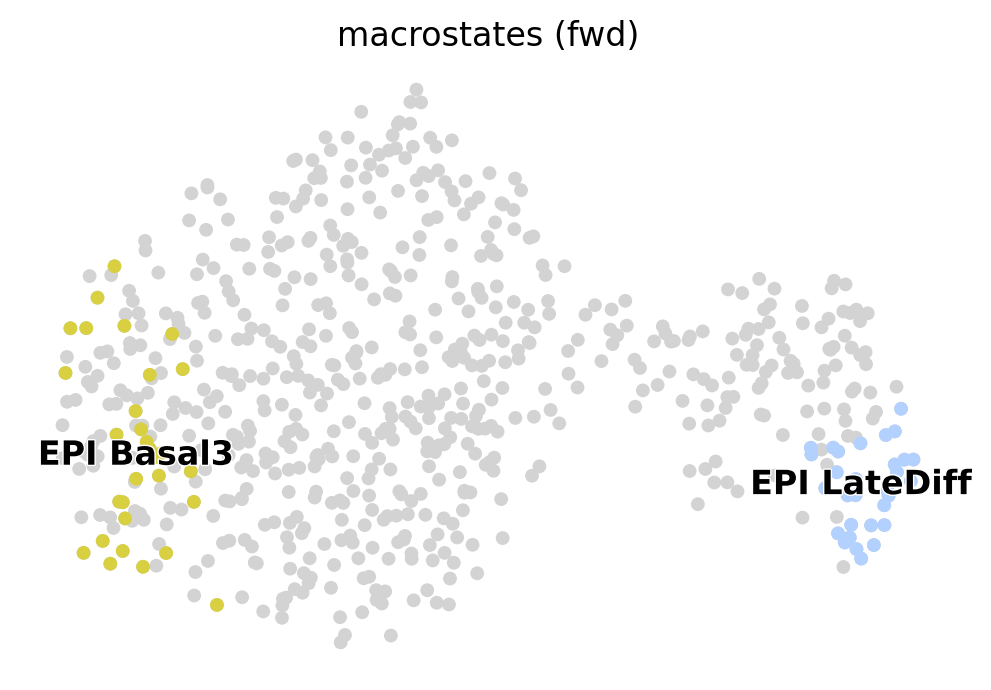

In [133]:
#Identify macrostates (needed for identifying lineage drivers of periderm maturation)
#n_states decides how many terminal states there should be
g.compute_macrostates(n_states=2, cluster_key='HC_named')
g.plot_macrostates(same_plot=False)
g.plot_macrostates(discrete=True)

In [134]:
#Compute absorption probabilities (needed for identifying lineage drivers of IFE differentiation)
g.set_terminal_states_from_macrostates()
g.compute_absorption_probabilities()

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:00:00)


recovering dynamics
    finished (0:02:00) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using root_cells, terminal_states_probs as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


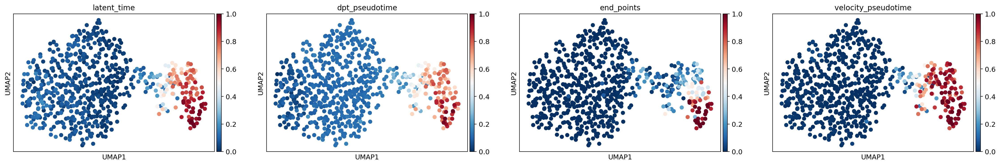

In [135]:
#Compute latent time and plot different methods for placing cells in a pseudotemporal order
scv.tl.recover_dynamics(adata_ife)
scv.tl.recover_latent_time(adata_ife, root_key='initial_states_probs', end_key='terminal_states_probs')
sc.pl.umap(adata_ife, color = ['latent_time', 'dpt_pseudotime', 'end_points','velocity_pseudotime'])
#Please note the large overlap between the different methods for placing cells in a pseudotemporal order (except dpt_pseudotime having reverse order)
# "Latent_time" was chosen as axis for plotting lineage drivers

No handles with labels found to put in legend.


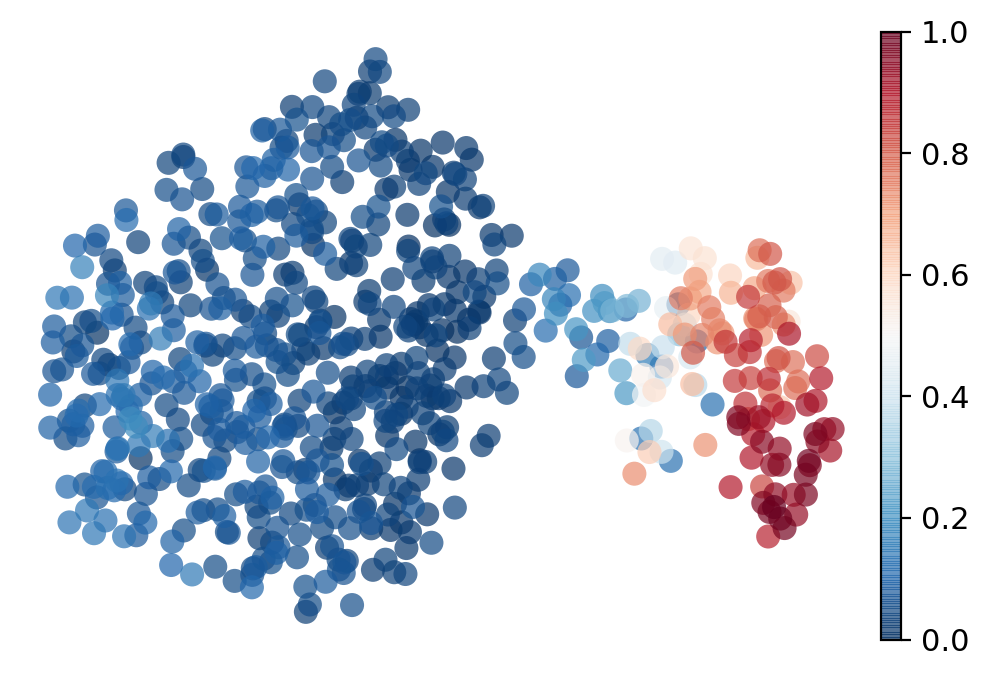

In [136]:
#Save plots
mult = 2
fig, ax = plt.subplots(figsize = (3*mult, 2*mult))
sc.pl.umap(adata_ife, ax = ax, show = False, frameon = False, s = 300, title = '', alpha = 0.7,color='latent_time')
ax.legend().remove()
ax.set_xlim(left = ax.get_xlim()[0]-ax.get_xlim()[0]*0.1)
fig.savefig(os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentiation_After-CC-Regression_Latent-Time.png'), transparent = True, bbox_inches = 'tight', dpi = 100)

In [137]:
#Identify lineage drivers for "EPI LateDiff" macrostate
cr.tl.lineage_drivers(adata_ife, lineages='EPI LateDiff', use_raw=False, backward=False)

Computing correlations for lineages `['EPI LateDiff']` restricted to clusters `None` in layer `X` with `use_raw=False`
Adding `.lineage_drivers`
       `adata.var['to EPI LateDiff corr']`
    Finish (0:00:00)


,EPI LateDiff corr,EPI LateDiff pval,EPI LateDiff qval,EPI LateDiff ci low,EPI LateDiff ci high
Mgst1,0.741712,1.072321e-135,1.361955e-131,0.705836,0.773794
Krtdap,0.738792,6.828922e-134,4.336707e-130,0.702579,0.771188
Nectin4,0.699221,4.805146e-112,2.034339e-108,0.658600,0.735780
Capns2,0.676967,1.487786e-101,3.779274e-98,0.633987,0.715778
Smtnl2,0.671376,4.335000e-99,9.176472e-96,0.627817,0.710742
...,...,...,...,...,...
Sparc,-0.595032,6.155086e-71,2.442992e-68,-0.641583,-0.544114
Cald1,-0.605484,2.861802e-74,1.298134e-71,-0.651096,-0.555514
Krt14,-0.618071,1.764012e-78,8.617199e-76,-0.662534,-0.569268
Fth1,-0.636056,6.717970e-85,5.154531e-82,-0.678841,-0.588967


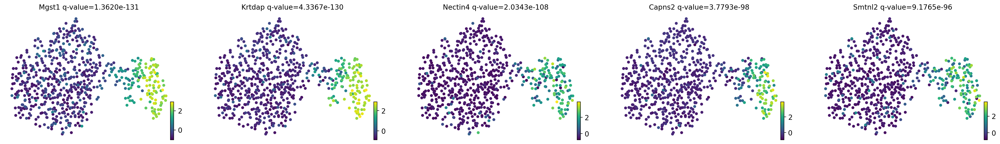

In [138]:
#Plot top 5 lineage drivers for "EPI LateDiff"
cr.pl.lineage_drivers(adata_ife, lineage="EPI LateDiff", n_genes=5)

In [139]:
#Generate GAM model
model = cr.ul.models.GAM(adata_ife, grid=None)

Computing trends using `1` core(s)


did not converge
did not converge
did not converge

    Finish (0:00:18)


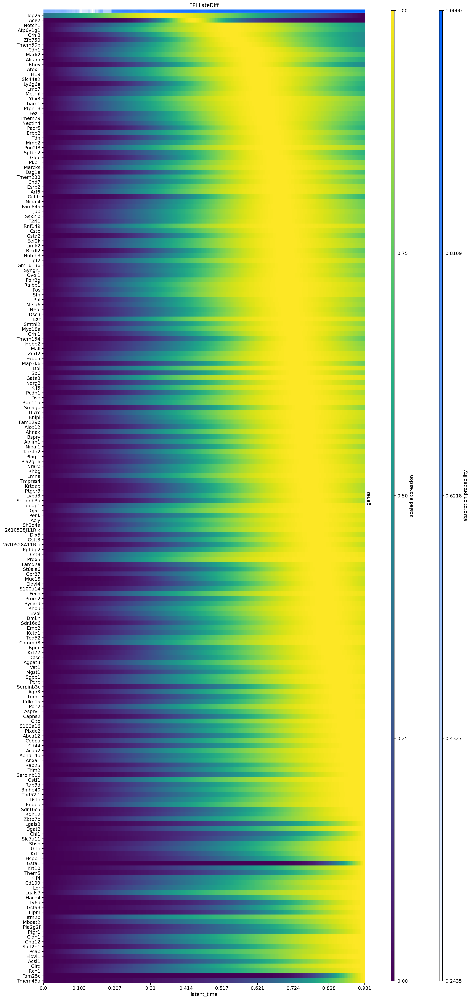

In [140]:
#Plot lineage drivers for IFE Differentiation (lineage drivers of "EPI LateDiff macrostate)
n_genes = 200
genes = adata_ife.var['to EPI LateDiff corr'].sort_values(ascending=False).index[:n_genes]
ax = cr.pl.heatmap(adata_ife, model, genes=genes, figsize = (15, n_genes/5),
              show_absorption_probabilities=True,
              lineages="EPI LateDiff", n_jobs=1, backend='loky', use_raw = True, show_all_genes=True)

40
Computing trends using `1` core(s)



    Finish (0:00:02)


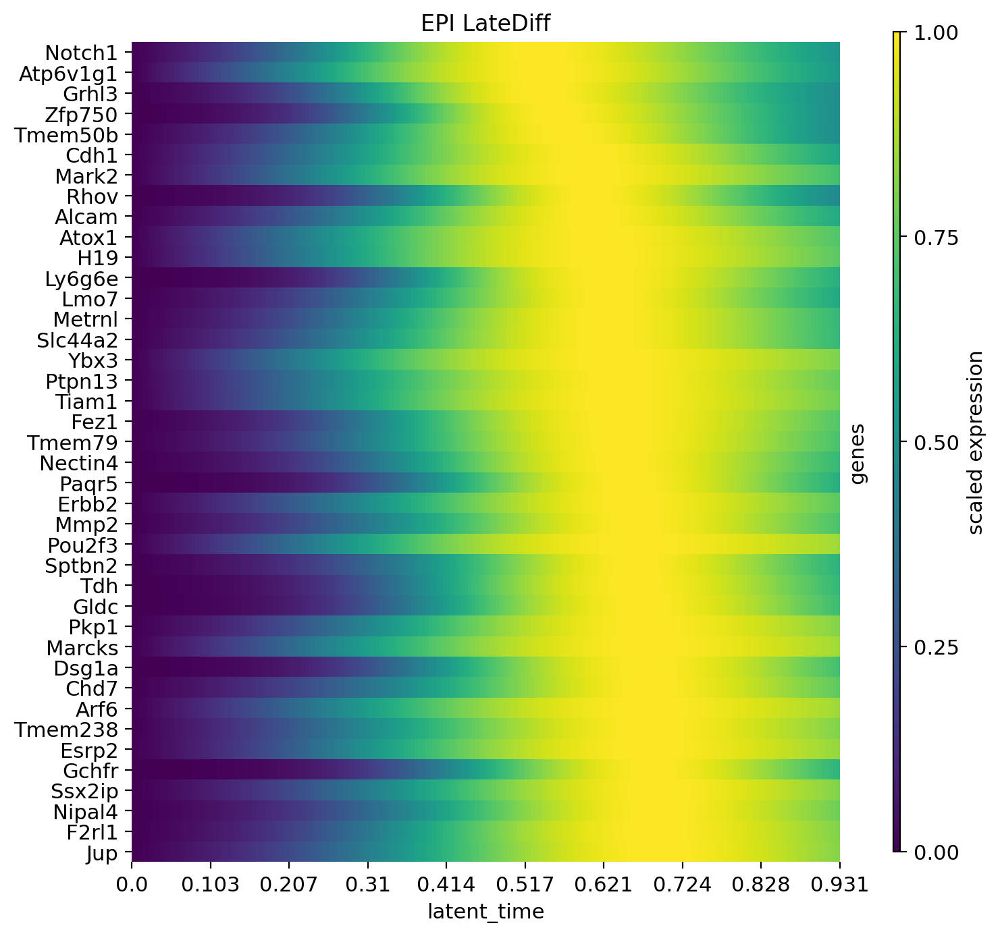

In [141]:
# Plot selected genes from the heatmap above. We manually selected genes that come up early in the IFE differentiation process
genes=['Notch1','Atp6v1g1','Grhl3','Zfp750','Tmem50b','Cdh1','Mark2','Rhov','Alcam','Atox1','H19','Ly6g6e','Lmo7','Metrnl','Slc44a2','Ybx3','Ptpn13','Tiam1','Fez1','Nectin4','Tmem79','Paqr5','Erbb2','Mmp2','Pou2f3','Sptbn2','Tdh','Gldc','Dsg1a','Pkp1','Marcks','Chd7','Arf6','Tmem238','Esrp2','Gchfr','Nipal4','F2rl1','Ssx2ip','Jup']
print(len(genes))
ax = cr.pl.heatmap(adata_ife, model, genes=genes, figsize = (8, 8),
              show_absorption_probabilities=False,
              lineages="EPI LateDiff", n_jobs=1, backend='loky', use_raw = True, show_all_genes=True,time_key='latent_time',save=os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentation_Heatmap1.png'),dpi=100)

3
Computing trends using `1` core(s)



    Finish (0:00:00)


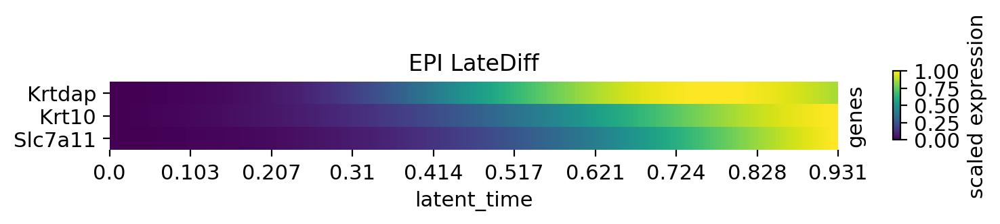

In [142]:
# Plot selected genes from the heatmap above. We manually selected a couple of well-known IFE differentiation markers for reference.
genes=['Krt10','Krtdap','Slc7a11']
print(len(genes))
ax = cr.pl.heatmap(adata_ife, model, genes=genes, figsize = (8, 1),
              show_absorption_probabilities=False,
              lineages="EPI LateDiff", n_jobs=1, backend='loky', use_raw = True, show_all_genes=True,time_key='latent_time',save=os.path.join(path, 'Notebook-Output', 'EPI_IFE-Differentation_Heatmap2.png'),dpi=100)

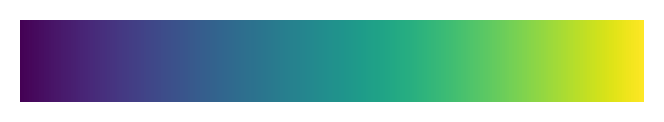

In [143]:
fig, ax = plt.subplots(figsize=(4, 1))
fig.subplots_adjust(bottom=0.5)
cb1 = mpl.colorbar.ColorbarBase(ax, cmap=plt.cm.viridis,
                                orientation='horizontal')
cb1.set_ticks([])
cb1.outline.set_visible(False)
fig.savefig(os.path.join(path, 'Notebook-Output', 'Colorbar_Viridis.png'), transparent = True, bbox_inches = 'tight', dpi = 100)

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


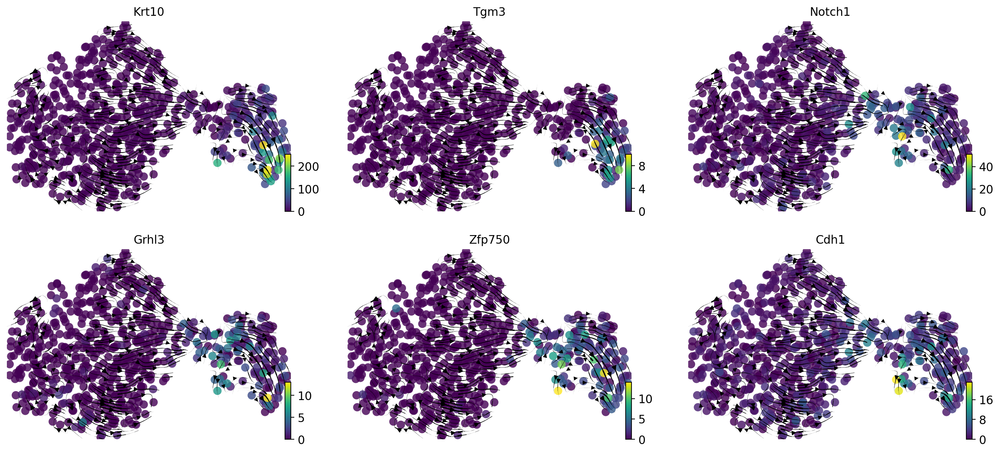

In [144]:
#Optional: Plot velocity arrows and gene expression onto UMAP
scv.pl.velocity_embedding_stream(adata_ife, color = ['Krt10','Tgm3', 'Notch1', 'Grhl3','Zfp750','Cdh1'], cmap = 'viridis', ncols = 3,alpha=0.8,size=300)

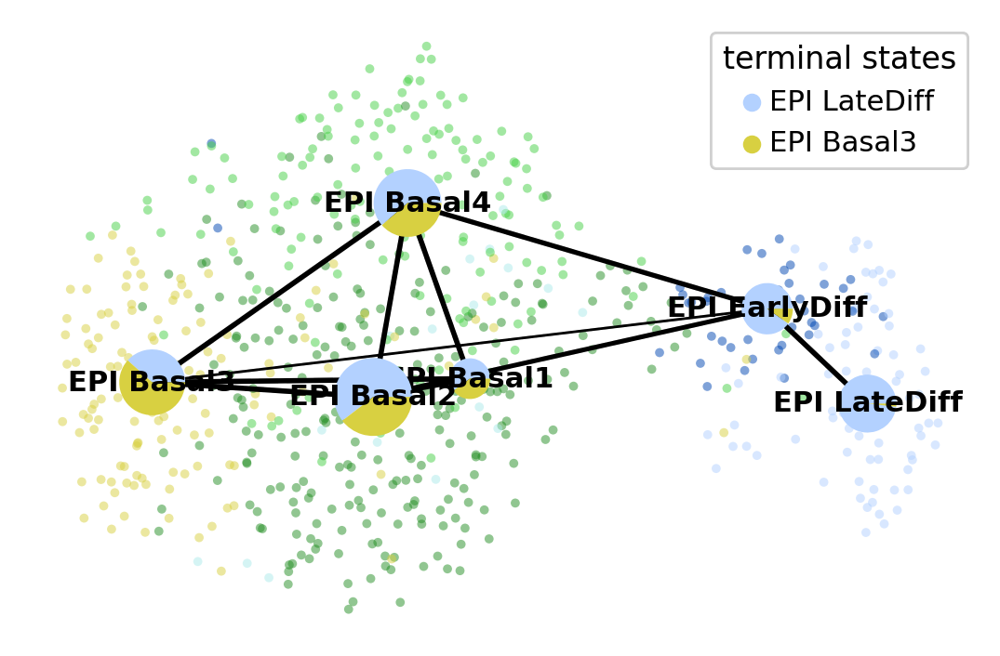

In [145]:
#Optional: PAGA to see if there are clear differences in fate for the different basal IFE clusters
sc.tl.paga(adata_ife, groups='HC_named')
cr.pl.cluster_fates(adata_ife, cluster_key='HC_named', mode='paga_pie', node_size_scale=4,
                    title='', edge_width_scale=1, max_edge_width=2, threshold=0.1, basis='umap')

## Save adata object as h5ad file

In [146]:
#h5ad file is provided on Zenodo
adata_ife.write_h5ad(os.path.join(path, 'Notebook-Output', 'Adata-object_{}-IFE-differentiation.h5'.format(cell_type)))